# Installing & Importing Libraries

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [39]:
!pip install keract
import keract

In [2]:
import pickle
import numpy as np
import pandas as pd
from PIL import Image
import albumentations as A
from IPython.display import SVG
import matplotlib.pyplot as plt
%matplotlib inline
import os, re, sys, random, shutil, cv2

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam, Nadam
from tensorflow.keras import applications, optimizers
from tensorflow.keras.applications.resnet50 import preprocess_input

from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.utils import model_to_dot, plot_model
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, CSVLogger, LearningRateScheduler
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, ZeroPadding2D, Dropout

# Working with Augmented Dataset

In [3]:
# train_images = "../input/augmented-dubai-aerial-imagery-dataset/train_images/"
# train_masks = "../input/augmented-dubai-aerial-imagery-dataset/train_masks/"
# val_images = "../input/augmented-dubai-aerial-imagery-dataset/val_images/"
# val_masks = "../input/augmented-dubai-aerial-imagery-dataset/val_masks/"
train_images = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/train_images/"
train_masks = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/train_masks/"
val_images = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/val_images/"
val_masks = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/val_masks/"

In [4]:
file_names = np.sort(os.listdir(train_images + 'train/'))
file_names = np.char.split(file_names, '.')
filenames = np.array([])
for i in range(len(file_names)):
    filenames = np.append(filenames, file_names[i][0])

In [6]:
# def show_data(files, original_images_dir, label_images_dir):

#     for file in files:
#         fig, axs = plt.subplots(1, 2, figsize=(15, 6), constrained_layout=True)

#         axs[0].imshow(cv2.resize(cv2.imread(original_images_dir+'train/'+str(file)+'.jpg'), (2000,1400)))
#         axs[0].set_title('Original Image', fontdict = {'fontsize':14, 'fontweight': 'medium'})
#         axs[0].set_xticks(np.arange(0, 2001, 200))
#         axs[0].set_yticks(np.arange(0, 1401, 200))
#         axs[0].grid(False)
#         axs[0].axis(True)

#         semantic_label_image = cv2.imread(label_images_dir+ 'train/'+str(file)+'.png')
#         semantic_label_image = cv2.cvtColor(semantic_label_image, cv2.COLOR_BGR2RGB)
#         semantic_label_image = cv2.resize(semantic_label_image, (2000,1400))
#         axs[1].imshow(semantic_label_image)
#         axs[1].set_title('Semantic Segmentation Mask', fontdict = {'fontsize':14, 'fontweight': 'medium'})
#         axs[1].set_xticks(np.arange(0, 2001, 200))
#         axs[1].set_yticks(np.arange(0, 1401, 200))
#         axs[1].grid(False)
#         axs[1].axis(True)

#         plt.savefig('./sample_'+file, facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 100)
#         plt.show()


# files = ['image_t4_003', 'image_t4_005', 'image_t6_002', 'image_t7_002', 'image_t8_003', 'image_t8_004', 'image_t8_006']
# show_data(files, train_images, train_masks)

In [7]:
import numpy as np
import pandas as pd

# Define class colors
class_building = '#3C1098'
class_building = class_building.lstrip('#')
class_building = np.array(tuple(int(class_building[i:i+2], 16) for i in (0,2,4)))

class_land = '#8429F6'
class_land = class_land.lstrip('#')
class_land = np.array(tuple(int(class_land[i:i+2], 16) for i in (0,2,4)))

class_road = '#6EC1E4'
class_road = class_road.lstrip('#')
class_road = np.array(tuple(int(class_road[i:i+2], 16) for i in (0,2,4)))

class_vegetation = '#FEDD3A'
class_vegetation = class_vegetation.lstrip('#')
class_vegetation = np.array(tuple(int(class_vegetation[i:i+2], 16) for i in (0,2,4)))

class_water = '#E2A929'
class_water = class_water.lstrip('#')
class_water = np.array(tuple(int(class_water[i:i+2], 16) for i in (0,2,4)))

class_unlabeled = '#9B9B9B'
class_unlabeled = class_unlabeled.lstrip('#')
class_unlabeled = np.array(tuple(int(class_unlabeled[i:i+2], 16) for i in (0,2,4)))

# Create DataFrame
data = {
    'name': ['building', 'land', 'road', 'vegetation', 'water', 'unlabeled'],
    'r': [class_building[0], class_land[0], class_road[0], class_vegetation[0], class_water[0], class_unlabeled[0]],
    'g': [class_building[1], class_land[1], class_road[1], class_vegetation[1], class_water[1], class_unlabeled[1]],
    'b': [class_building[2], class_land[2], class_road[2], class_vegetation[2], class_water[2], class_unlabeled[2]]
}

df = pd.DataFrame(data)

# Save DataFrame to CSV
df.to_csv('class_colors.csv', index=False)


In [8]:
class_dict_df = pd.read_csv('/content/class_colors.csv', index_col=False, skipinitialspace=True)
class_dict_df

,name,r,g,b
0,building,60,16,152
1,land,132,41,246
2,road,110,193,228
3,vegetation,254,221,58
4,water,226,169,41
5,unlabeled,155,155,155


In [9]:
label_names= list(class_dict_df.name)
label_codes = []
r= np.asarray(class_dict_df.r)
g= np.asarray(class_dict_df.g)
b= np.asarray(class_dict_df.b)

for i in range(len(class_dict_df)):
    label_codes.append(tuple([r[i], g[i], b[i]]))

label_codes, label_names

([(60, 16, 152),
  (132, 41, 246),
  (110, 193, 228),
  (254, 221, 58),
  (226, 169, 41),
  (155, 155, 155)],
 ['building', 'land', 'road', 'vegetation', 'water', 'unlabeled'])

# Create Useful Label & Code Conversion Dictionaries

These will be used for:

* One hot encoding the mask labels for model training
* Decoding the predicted labels for interpretation and visualization

In [10]:
code2id = {v:k for k,v in enumerate(label_codes)}
id2code = {k:v for k,v in enumerate(label_codes)}

name2id = {v:k for k,v in enumerate(label_names)}
id2name = {k:v for k,v in enumerate(label_names)}

In [11]:
id2code

{0: (60, 16, 152),
 1: (132, 41, 246),
 2: (110, 193, 228),
 3: (254, 221, 58),
 4: (226, 169, 41),
 5: (155, 155, 155)}

In [12]:
id2name

{0: 'building',
 1: 'land',
 2: 'road',
 3: 'vegetation',
 4: 'water',
 5: 'unlabeled'}

# Define Functions for One Hot Encoding RGB Labels & Decoding Encoded Predictions

In [13]:
def rgb_to_onehot(rgb_image, colormap = id2code):
    '''Function to one hot encode RGB mask labels
        Inputs:
            rgb_image - image matrix (eg. 256 x 256 x 3 dimension numpy ndarray)
            colormap - dictionary of color to label id
        Output: One hot encoded image of dimensions (height x width x num_classes) where num_classes = len(colormap)
    '''
    num_classes = len(colormap)
    shape = rgb_image.shape[:2]+(num_classes,)
    encoded_image = np.zeros( shape, dtype=np.int8 )
    for i, cls in enumerate(colormap):
        encoded_image[:,:,i] = np.all(rgb_image.reshape( (-1,3) ) == colormap[i], axis=1).reshape(shape[:2])
    return encoded_image


def onehot_to_rgb(onehot, colormap = id2code):
    '''Function to decode encoded mask labels
        Inputs:
            onehot - one hot encoded image matrix (height x width x num_classes)
            colormap - dictionary of color to label id
        Output: Decoded RGB image (height x width x 3)
    '''
    single_layer = np.argmax(onehot, axis=-1)
    output = np.zeros( onehot.shape[:2]+(3,) )
    for k in colormap.keys():
        output[single_layer==k] = colormap[k]
    return np.uint8(output)

# Creating Custom Image Data Generators
## Defining Data Generators

In [14]:
# Normalizing only frame images, since masks contain label info
data_gen_args = dict(rescale=1./255)
mask_gen_args = dict()

train_frames_datagen = ImageDataGenerator(**data_gen_args)
train_masks_datagen = ImageDataGenerator(**mask_gen_args)
val_frames_datagen = ImageDataGenerator(**data_gen_args)
val_masks_datagen = ImageDataGenerator(**mask_gen_args)

# Seed defined for aligning images and their masks
seed = 1

# Custom Image Data Generators for Creating Batches of Frames and Masks

In [25]:
def TrainAugmentGenerator(train_images_dir, train_masks_dir, seed=1, batch_size=8, target_size=(512, 512)):
    train_image_generator = train_frames_datagen.flow_from_directory(
        train_images_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    train_mask_generator = train_masks_datagen.flow_from_directory(
        train_masks_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    while True:
        X1i = train_image_generator.next()
        X2i = train_mask_generator.next()

        # One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x, :, :, :], id2code) for x in range(X2i[0].shape[0])]

        yield X1i[0], np.asarray(mask_encoded)


def ValAugmentGenerator(val_images_dir, val_masks_dir, seed=1, batch_size=8, target_size=(512, 512)):
    val_image_generator = val_frames_datagen.flow_from_directory(
        val_images_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    val_mask_generator = val_masks_datagen.flow_from_directory(
        val_masks_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    while True:
        X1i = val_image_generator.next()
        X2i = val_mask_generator.next()

        # One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x, :, :, :], id2code) for x in range(X2i[0].shape[0])]

        yield X1i[0], np.asarray(mask_encoded)


In [15]:
# def TrainAugmentGenerator(train_images_dir, train_masks_dir, seed = 1, batch_size = 8, target_size = (512, 512)):
#     '''Train Image data generator
#         Inputs:
#             seed - seed provided to the flow_from_directory function to ensure aligned data flow
#             batch_size - number of images to import at a time
#             train_images_dir - train images directory
#             train_masks_dir - train masks directory
#             target_size - tuple of integers (height, width)

#         Output: Decoded RGB image (height x width x 3)
#     '''
#     train_image_generator = train_frames_datagen.flow_from_directory(
#     train_images_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)

#     train_mask_generator = train_masks_datagen.flow_from_directory(
#     train_masks_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)

#     while True:
#         X1i = train_image_generator.next()
#         X2i = train_mask_generator.next()

#         #One hot encoding RGB images
#         mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]

#         yield X1i[0], np.asarray(mask_encoded)

# def ValAugmentGenerator(val_images_dir, val_masks_dir, seed = 1, batch_size = 8, target_size = (512, 512)):
#     '''Validation Image data generator
#         Inputs:
#             seed - seed provided to the flow_from_directory function to ensure aligned data flow
#             batch_size - number of images to import at a time
#             val_images_dir - validation images directory
#             val_masks_dir - validation masks directory
#             target_size - tuple of integers (height, width)

#         Output: Decoded RGB image (height x width x 3)
#     '''
#     val_image_generator = val_frames_datagen.flow_from_directory(
#     val_images_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)


#     val_mask_generator = val_masks_datagen.flow_from_directory(
#     val_masks_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)


#     while True:
#         X1i = val_image_generator.next()
#         X2i = val_mask_generator.next()

#         #One hot encoding RGB images
#         mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]

#         yield X1i[0], np.asarray(mask_encoded)

# Model

In [16]:
batch_size = 16
num_train_samples = len(np.sort(os.listdir(train_images+'train')))
num_val_samples = len(np.sort(os.listdir(val_images+'val')))
steps_per_epoch = np.ceil(float(num_train_samples) / float(batch_size))
print('steps_per_epoch: ', steps_per_epoch)
validation_steps = np.ceil(float(4 * num_val_samples) / float(batch_size))
print('validation_steps: ', validation_steps)

steps_per_epoch:  35.0
validation_steps:  18.0


## VGG19-UNet

In [27]:
import numpy as np
import os
import cv2
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPooling2D, UpSampling2D, Concatenate, Dropout


# Define the model architecture
def build_inception_resnetv2_like_model(input_shape):
    inputs = Input(shape=input_shape)

    # Encoder
    conv1 = Conv2D(32, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv2D(32, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(64, 3, activation='relu', padding='same')(pool1)
    conv2 = Conv2D(64, 3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(128, 3, activation='relu', padding='same')(pool2)
    conv3 = Conv2D(128, 3, activation='relu', padding='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(256, 3, activation='relu', padding='same')(pool3)
    conv4 = Conv2D(256, 3, activation='relu', padding='same')(conv4)

    # Decoder
    up5 = UpSampling2D(size=(2, 2))(conv4)
    merge5 = Concatenate()([conv3, up5])
    conv5 = Conv2D(128, 3, activation='relu', padding='same')(merge5)
    conv5 = Conv2D(128, 3, activation='relu', padding='same')(conv5)

    up6 = UpSampling2D(size=(2, 2))(conv5)
    merge6 = Concatenate()([conv2, up6])
    conv6 = Conv2D(64, 3, activation='relu', padding='same')(merge6)
    conv6 = Conv2D(64, 3, activation='relu', padding='same')(conv6)

    up7 = UpSampling2D(size=(2, 2))(conv6)
    merge7 = Concatenate()([conv1, up7])
    conv7 = Conv2D(32, 3, activation='relu', padding='same')(merge7)
    conv7 = Conv2D(32, 3, activation='relu', padding='same')(conv7)

    # Output layer
    outputs = Conv2D(6, 1, activation='softmax')(conv7)

    model = Model(inputs=inputs, outputs=outputs, name='InceptionResNetV2_Like_Model')
    return model


In [28]:
K.clear_session()

def dice_coef(y_true, y_pred):
    return (2. * K.sum(y_true * y_pred) + 1.) / (K.sum(y_true) + K.sum(y_pred) + 1.)

model = build_inception_resnetv2_like_model(input_shape=(512, 512, 3))
model.compile(optimizer=Adam(lr = 0.0001), loss='categorical_crossentropy', metrics=[dice_coef, "accuracy"])
model.summary()

Model: "InceptionResNetV2_Like_Model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 512, 512, 32)         896       ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 512, 512, 32)         9248      ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 256, 256, 32)         0         ['conv2d_1[0][0]']            
 D)                                                                    

### Model Layout

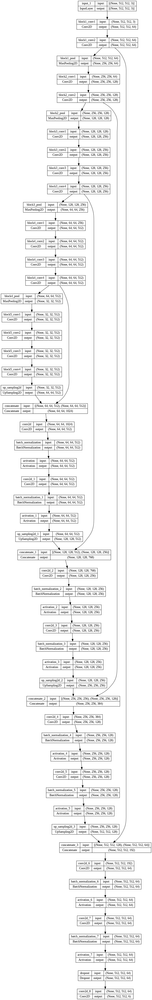

In [ ]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True, expand_nested=True)

# Model Training

In [21]:
import numpy as np
import tensorflow as tf
from sklearn.metrics import precision_score, recall_score, f1_score

class MetricsCallback(tf.keras.callbacks.Callback):
    def __init__(self, validation_data):
        super(MetricsCallback, self).__init__()
        self.validation_data = validation_data

    def on_epoch_end(self, epoch, logs=None):
        val_preds = self.model.predict(self.validation_data[0])
        val_true = self.validation_data[1]

        val_preds_argmax = np.argmax(val_preds, axis=-1)
        val_true_argmax = np.argmax(val_true, axis=-1)

        val_recall = recall_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')
        val_precision = precision_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')
        val_f1 = f1_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')

        print(f' - val_recall: {val_recall:.4f} - val_precision: {val_precision:.4f} - val_f1: {val_f1:.4f}')

In [22]:
val_data = next(ValAugmentGenerator(val_images_dir=val_images, val_masks_dir=val_masks, target_size=(512, 512)))

# Instantiate the MetricsCallback
metrics_callback = MetricsCallback(validation_data=val_data)

Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.


In [29]:
def exponential_decay(lr0, s):
    def exponential_decay_fn(epoch):
        return lr0 * 0.1 **(epoch / s)
    return exponential_decay_fn

exponential_decay_fn = exponential_decay(0.0001, 60)

lr_scheduler = LearningRateScheduler(
    exponential_decay_fn,
    verbose=1
)

checkpoint = ModelCheckpoint(
    filepath = 'simple_InceptionResNetV2.h5',
    save_best_only = True,
#     save_weights_only = False,
    monitor = 'val_loss',
    mode = 'auto',
    verbose = 1
)

earlystop = EarlyStopping(
    monitor = 'val_loss',
    min_delta = 0.001,
    patience = 12,
    mode = 'auto',
    verbose = 1,
    restore_best_weights = True
)

csvlogger = CSVLogger(
    filename= "model_training.csv",
    separator = ",",
    append = False
)

callbacks = [checkpoint, earlystop, csvlogger, lr_scheduler, metrics_callback]

In [30]:
history = model.fit(
    TrainAugmentGenerator(train_images_dir = train_images, train_masks_dir = train_masks, target_size = (512, 512)),
    steps_per_epoch=steps_per_epoch,
    validation_data = ValAugmentGenerator(val_images_dir = val_images, val_masks_dir = val_masks, target_size = (512, 512)),
    validation_steps = validation_steps,
    epochs = 50,
    callbacks=callbacks,
    use_multiprocessing=False,
    verbose=1
)

Found 548 images belonging to 1 classes.
Found 548 images belonging to 1 classes.

Epoch 1: LearningRateScheduler setting learning rate to 0.0001.
Epoch 1/50
35/35 [==============================] - ETA: 0s - loss: 1.4689 - dice_coef: 0.3044 - accuracy: 0.4610Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.

Epoch 1: val_loss improved from inf to 1.37352, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 215ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.1666 - val_precision: 0.0777 - val_f1: 0.0698
35/35 [==============================] - 246s 6s/step - loss: 1.4689 - dice_coef: 0.3044 - accuracy: 0.4610 - val_loss: 1.3735 - val_dice_coef: 0.3512 - val_accuracy: 0.4226 - lr: 1.0000e-04

Epoch 2: LearningRateScheduler setting learning rate to 9.623506263980886e-05.
Epoch 2/50
35/35 [==============================] - ETA: 0s - loss: 1.2993 - dice_coef: 0.3814 - accuracy: 0.4812
Epoch 2: val_loss improved from 1.37352 to 1.32466, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 46ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.1666 - val_precision: 0.2430 - val_f1: 0.0698
35/35 [==============================] - 172s 5s/step - loss: 1.2993 - dice_coef: 0.3814 - accuracy: 0.4812 - val_loss: 1.3247 - val_dice_coef: 0.3727 - val_accuracy: 0.4253 - lr: 9.6235e-05

Epoch 3: LearningRateScheduler setting learning rate to 9.261187281287936e-05.
Epoch 3/50
35/35 [==============================] - ETA: 0s - loss: 1.2004 - dice_coef: 0.4251 - accuracy: 0.5553
Epoch 3: val_loss improved from 1.32466 to 1.04293, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 33ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3061 - val_precision: 0.2334 - val_f1: 0.2234
35/35 [==============================] - 47s 1s/step - loss: 1.2004 - dice_coef: 0.4251 - accuracy: 0.5553 - val_loss: 1.0429 - val_dice_coef: 0.4751 - val_accuracy: 0.6514 - lr: 9.2612e-05

Epoch 4: LearningRateScheduler setting learning rate to 8.912509381337456e-05.
Epoch 4/50
35/35 [==============================] - ETA: 0s - loss: 1.0695 - dice_coef: 0.4899 - accuracy: 0.6057
Epoch 4: val_loss improved from 1.04293 to 0.92846, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 53ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3118 - val_precision: 0.3096 - val_f1: 0.2368
35/35 [==============================] - 49s 1s/step - loss: 1.0695 - dice_coef: 0.4899 - accuracy: 0.6057 - val_loss: 0.9285 - val_dice_coef: 0.5112 - val_accuracy: 0.6908 - lr: 8.9125e-05

Epoch 5: LearningRateScheduler setting learning rate to 8.576958985908941e-05.
Epoch 5/50
35/35 [==============================] - ETA: 0s - loss: 0.9587 - dice_coef: 0.5351 - accuracy: 0.6539
Epoch 5: val_loss improved from 0.92846 to 0.90041, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 42ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4316 - val_precision: 0.3975 - val_f1: 0.3721
35/35 [==============================] - 43s 1s/step - loss: 0.9587 - dice_coef: 0.5351 - accuracy: 0.6539 - val_loss: 0.9004 - val_dice_coef: 0.5224 - val_accuracy: 0.7190 - lr: 8.5770e-05

Epoch 6: LearningRateScheduler setting learning rate to 8.254041852680184e-05.
Epoch 6/50
35/35 [==============================] - ETA: 0s - loss: 0.9647 - dice_coef: 0.5305 - accuracy: 0.6560
Epoch 6: val_loss improved from 0.90041 to 0.88262, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 43ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4222 - val_precision: 0.3860 - val_f1: 0.3681
35/35 [==============================] - 43s 1s/step - loss: 0.9647 - dice_coef: 0.5305 - accuracy: 0.6560 - val_loss: 0.8826 - val_dice_coef: 0.5603 - val_accuracy: 0.7031 - lr: 8.2540e-05

Epoch 7: LearningRateScheduler setting learning rate to 7.943282347242815e-05.
Epoch 7/50
35/35 [==============================] - ETA: 0s - loss: 0.9397 - dice_coef: 0.5331 - accuracy: 0.6563
Epoch 7: val_loss improved from 0.88262 to 0.79478, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 34ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4403 - val_precision: 0.4121 - val_f1: 0.3953
35/35 [==============================] - 43s 1s/step - loss: 0.9397 - dice_coef: 0.5331 - accuracy: 0.6563 - val_loss: 0.7948 - val_dice_coef: 0.6253 - val_accuracy: 0.7350 - lr: 7.9433e-05

Epoch 8: LearningRateScheduler setting learning rate to 7.644222742526003e-05.
Epoch 8/50
35/35 [==============================] - ETA: 0s - loss: 0.8944 - dice_coef: 0.5657 - accuracy: 0.6840
Epoch 8: val_loss did not improve from 0.79478
1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4225 - val_precision: 0.3951 - val_f1: 0.3768
35/35 [==============================] - 43s 1s/step - loss: 0.8944 - dice_coef: 0.5657 - accuracy: 0.6840 - val_loss: 0.8758 - val_dice_coef: 0.5411 - val_accuracy: 0.6981 - lr: 7.6442e-05

Epoch 9: LearningRateScheduler setting learning rate to 7.356422544596415e-05.
Epoch 9/50
35/35 [==============================] - ETA: 0s - loss: 0.8821 - dice_coef: 0.5628 - accuracy: 0.6816
Epoch 9: val_loss improved from 0.79478 to 0.78069, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 33ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4584 - val_precision: 0.4456 - val_f1: 0.4179
35/35 [==============================] - 42s 1s/step - loss: 0.8821 - dice_coef: 0.5628 - accuracy: 0.6816 - val_loss: 0.7807 - val_dice_coef: 0.5960 - val_accuracy: 0.7271 - lr: 7.3564e-05

Epoch 10: LearningRateScheduler setting learning rate to 7.07945784384138e-05.
Epoch 10/50
35/35 [==============================] - ETA: 0s - loss: 0.8683 - dice_coef: 0.5699 - accuracy: 0.6788
Epoch 10: val_loss did not improve from 0.78069
1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4517 - val_precision: 0.4393 - val_f1: 0.4087
35/35 [==============================] - 44s 1s/step - loss: 0.8683 - dice_coef: 0.5699 - accuracy: 0.6788 - val_loss: 0.7850 - val_dice_coef: 0.6254 - val_accuracy: 0.7272 - lr: 7.0795e-05

Epoch 11: LearningRateScheduler setting learning rate to 6.812920690579614e-05.
Epoch 11/50
35/35 [==============================] - ETA: 0s - loss: 0.8932 - dice_coef: 0.5579 - accuracy: 0.6721
Epoch 11: val_loss did not improve from 0.78069
1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4765 - val_precision: 0.4851 - val_f1: 0.4429
35/35 [==============================] - 42s 1s/step - loss: 0.8932 - dice_coef: 0.5579 - accuracy: 0.6721 - val_loss: 0.7855 - val_dice_coef: 0.6015 - val_accuracy: 0.7218 - lr: 6.8129e-05

Epoch 12: LearningRateScheduler setting learning rate to 6.556418494179789e-05.
Epoch 12/50
35/35 [==============================] - ETA: 0s - loss: 0.8576 - dice_coef: 0.5733 - accuracy: 0.6848
Epoch 12: val_loss improved from 0.78069 to 0.75959, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 46ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4611 - val_precision: 0.4628 - val_f1: 0.4237
35/35 [==============================] - 43s 1s/step - loss: 0.8576 - dice_coef: 0.5733 - accuracy: 0.6848 - val_loss: 0.7596 - val_dice_coef: 0.6146 - val_accuracy: 0.7270 - lr: 6.5564e-05

Epoch 13: LearningRateScheduler setting learning rate to 6.309573444801933e-05.
Epoch 13/50
35/35 [==============================] - ETA: 0s - loss: 0.8595 - dice_coef: 0.5769 - accuracy: 0.6872
Epoch 13: val_loss did not improve from 0.75959
1/1 [==============================] - 0s 42ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5014 - val_precision: 0.5025 - val_f1: 0.4708
35/35 [==============================] - 43s 1s/step - loss: 0.8595 - dice_coef: 0.5769 - accuracy: 0.6872 - val_loss: 0.7732 - val_dice_coef: 0.6036 - val_accuracy: 0.7318 - lr: 6.3096e-05

Epoch 14: LearningRateScheduler setting learning rate to 6.072021956909886e-05.
Epoch 14/50
35/35 [==============================] - ETA: 0s - loss: 0.8561 - dice_coef: 0.5783 - accuracy: 0.6886
Epoch 14: val_loss did not improve from 0.75959
1/1 [==============================] - 0s 40ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4668 - val_precision: 0.4827 - val_f1: 0.4351
35/35 [==============================] - 43s 1s/step - loss: 0.8561 - dice_coef: 0.5783 - accuracy: 0.6886 - val_loss: 0.8063 - val_dice_coef: 0.6087 - val_accuracy: 0.7153 - lr: 6.0720e-05

Epoch 15: LearningRateScheduler setting learning rate to 5.8434141337351765e-05.
Epoch 15/50
35/35 [==============================] - ETA: 0s - loss: 0.8056 - dice_coef: 0.6013 - accuracy: 0.7101
Epoch 15: val_loss did not improve from 0.75959
1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4776 - val_precision: 0.4719 - val_f1: 0.4571
35/35 [==============================] - 43s 1s/step - loss: 0.8056 - dice_coef: 0.6013 - accuracy: 0.7101 - val_loss: 0.7617 - val_dice_coef: 0.6368 - val_accuracy: 0.7430 - lr: 5.8434e-05

Epoch 16: LearningRateScheduler setting learning rate to 5.623413251903491e-05.
Epoch 16/50
35/35 [==============================] - ETA: 0s - loss: 0.8807 - dice_coef: 0.5593 - accuracy: 0.6730
Epoch 16: val_loss improved from 0.75959 to 0.74221, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 33ms/step
 - val_recall: 0.4844 - val_precision: 0.5020 - val_f1: 0.4563
35/35 [==============================] - 65s 2s/step - loss: 0.8807 - dice_coef: 0.5593 - accuracy: 0.6730 - val_loss: 0.7422 - val_dice_coef: 0.6324 - val_accuracy: 0.7327 - lr: 5.6234e-05

Epoch 17: LearningRateScheduler setting learning rate to 5.4116952654646367e-05.
Epoch 17/50
35/35 [==============================] - ETA: 0s - loss: 0.8648 - dice_coef: 0.5724 - accuracy: 0.6828
Epoch 17: val_loss did not improve from 0.74221
1/1 [==============================] - 0s 30ms/step
 - val_recall: 0.4668 - val_precision: 0.4651 - val_f1: 0.4437
35/35 [==============================] - 43s 1s/step - loss: 0.8648 - dice_coef: 0.5724 - accuracy: 0.6828 - val_loss: 0.7620 - val_dice_coef: 0.5982 - val_accuracy: 0.7396 - lr: 5.4117e-05

Epoch 18: LearningRateScheduler setting learning rate to 5.2079483285954645e-05.
Epoch 18/50
35/35 [==============================] - ETA: 0s - 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 30ms/step
 - val_recall: 0.4737 - val_precision: 0.4813 - val_f1: 0.4487
35/35 [==============================] - 43s 1s/step - loss: 0.8183 - dice_coef: 0.5978 - accuracy: 0.7017 - val_loss: 0.7234 - val_dice_coef: 0.6234 - val_accuracy: 0.7434 - lr: 5.2079e-05

Epoch 19: LearningRateScheduler setting learning rate to 5.011872336272724e-05.
Epoch 19/50
35/35 [==============================] - ETA: 0s - loss: 0.7939 - dice_coef: 0.6012 - accuracy: 0.7102
Epoch 19: val_loss did not improve from 0.72340
1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5077 - val_precision: 0.5103 - val_f1: 0.4912
35/35 [==============================] - 42s 1s/step - loss: 0.7939 - dice_coef: 0.6012 - accuracy: 0.7102 - val_loss: 0.7293 - val_dice_coef: 0.6212 - val_accuracy: 0.7409 - lr: 5.0119e-05

Epoch 20: LearningRateScheduler setting learning rate to 4.8231784822393075e-05.
Epoch 20/50
35/35 [==============================] - ETA: 0s - loss: 0.8499 - dice_coef: 0.5766 - accuracy: 0.6846
Epoch 20: val_loss did not improve from 0.72340
1/1 [==============================] - 0s 30ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5048 - val_precision: 0.5144 - val_f1: 0.4796
35/35 [==============================] - 43s 1s/step - loss: 0.8499 - dice_coef: 0.5766 - accuracy: 0.6846 - val_loss: 0.7351 - val_dice_coef: 0.6158 - val_accuracy: 0.7431 - lr: 4.8232e-05

Epoch 21: LearningRateScheduler setting learning rate to 4.641588833612779e-05.
Epoch 21/50
35/35 [==============================] - ETA: 0s - loss: 0.8186 - dice_coef: 0.5920 - accuracy: 0.7062
Epoch 21: val_loss improved from 0.72340 to 0.71695, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5030 - val_precision: 0.5203 - val_f1: 0.4751
35/35 [==============================] - 43s 1s/step - loss: 0.8186 - dice_coef: 0.5920 - accuracy: 0.7062 - val_loss: 0.7169 - val_dice_coef: 0.6379 - val_accuracy: 0.7423 - lr: 4.6416e-05

Epoch 22: LearningRateScheduler setting learning rate to 4.4668359215096314e-05.
Epoch 22/50
35/35 [==============================] - ETA: 0s - loss: 0.8054 - dice_coef: 0.5969 - accuracy: 0.7048
Epoch 22: val_loss did not improve from 0.71695
1/1 [==============================] - 0s 45ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5070 - val_precision: 0.5078 - val_f1: 0.4942
35/35 [==============================] - 64s 2s/step - loss: 0.8054 - dice_coef: 0.5969 - accuracy: 0.7048 - val_loss: 0.7382 - val_dice_coef: 0.6412 - val_accuracy: 0.7434 - lr: 4.4668e-05

Epoch 23: LearningRateScheduler setting learning rate to 4.298662347082277e-05.
Epoch 23/50
35/35 [==============================] - ETA: 0s - loss: 0.8084 - dice_coef: 0.5956 - accuracy: 0.7028
Epoch 23: val_loss improved from 0.71695 to 0.71616, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 42ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5082 - val_precision: 0.5309 - val_f1: 0.4888
35/35 [==============================] - 42s 1s/step - loss: 0.8084 - dice_coef: 0.5956 - accuracy: 0.7028 - val_loss: 0.7162 - val_dice_coef: 0.6463 - val_accuracy: 0.7411 - lr: 4.2987e-05

Epoch 24: LearningRateScheduler setting learning rate to 4.136820402388507e-05.
Epoch 24/50
35/35 [==============================] - ETA: 0s - loss: 0.7747 - dice_coef: 0.6148 - accuracy: 0.7253
Epoch 24: val_loss did not improve from 0.71616
1/1 [==============================] - 0s 33ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5089 - val_precision: 0.5153 - val_f1: 0.5005
35/35 [==============================] - 43s 1s/step - loss: 0.7747 - dice_coef: 0.6148 - accuracy: 0.7253 - val_loss: 0.7185 - val_dice_coef: 0.6512 - val_accuracy: 0.7446 - lr: 4.1368e-05

Epoch 25: LearningRateScheduler setting learning rate to 3.981071705534973e-05.
Epoch 25/50
35/35 [==============================] - ETA: 0s - loss: 0.7633 - dice_coef: 0.6187 - accuracy: 0.7230
Epoch 25: val_loss did not improve from 0.71616
1/1 [==============================] - 0s 30ms/step
 - val_recall: 0.5078 - val_precision: 0.5211 - val_f1: 0.4858
35/35 [==============================] - 43s 1s/step - loss: 0.7633 - dice_coef: 0.6187 - accuracy: 0.7230 - val_loss: 0.7403 - val_dice_coef: 0.6465 - val_accuracy: 0.7469 - lr: 3.9811e-05

Epoch 26: LearningRateScheduler setting learning rate to 3.8311868495572876e-05.
Epoch 26/50
35/35 [==============================] - ETA: 0s - loss: 0.8069 - dice_coef: 0.5948 - accuracy: 0.7063
E

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 33ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5280 - val_precision: 0.5343 - val_f1: 0.5208
35/35 [==============================] - 42s 1s/step - loss: 0.8069 - dice_coef: 0.5948 - accuracy: 0.7063 - val_loss: 0.7038 - val_dice_coef: 0.6325 - val_accuracy: 0.7492 - lr: 3.8312e-05

Epoch 27: LearningRateScheduler setting learning rate to 3.6869450645195756e-05.
Epoch 27/50
35/35 [==============================] - ETA: 0s - loss: 0.7892 - dice_coef: 0.6061 - accuracy: 0.7144
Epoch 27: val_loss improved from 0.70380 to 0.70205, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 43ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5266 - val_precision: 0.5345 - val_f1: 0.5174
35/35 [==============================] - 44s 1s/step - loss: 0.7892 - dice_coef: 0.6061 - accuracy: 0.7144 - val_loss: 0.7021 - val_dice_coef: 0.6145 - val_accuracy: 0.7579 - lr: 3.6869e-05

Epoch 28: LearningRateScheduler setting learning rate to 3.548133892335755e-05.
Epoch 28/50
35/35 [==============================] - ETA: 0s - loss: 0.7765 - dice_coef: 0.6094 - accuracy: 0.7186
Epoch 28: val_loss improved from 0.70205 to 0.69470, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 48ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5330 - val_precision: 0.5510 - val_f1: 0.5144
35/35 [==============================] - 42s 1s/step - loss: 0.7765 - dice_coef: 0.6094 - accuracy: 0.7186 - val_loss: 0.6947 - val_dice_coef: 0.6515 - val_accuracy: 0.7523 - lr: 3.5481e-05

Epoch 29: LearningRateScheduler setting learning rate to 3.4145488738336015e-05.
Epoch 29/50
35/35 [==============================] - ETA: 0s - loss: 0.7809 - dice_coef: 0.6098 - accuracy: 0.7212
Epoch 29: val_loss improved from 0.69470 to 0.66812, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 30ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5340 - val_precision: 0.5496 - val_f1: 0.5275
35/35 [==============================] - 43s 1s/step - loss: 0.7809 - dice_coef: 0.6098 - accuracy: 0.7212 - val_loss: 0.6681 - val_dice_coef: 0.6571 - val_accuracy: 0.7617 - lr: 3.4145e-05

Epoch 30: LearningRateScheduler setting learning rate to 3.285993247600655e-05.
Epoch 30/50
35/35 [==============================] - ETA: 0s - loss: 0.7459 - dice_coef: 0.6199 - accuracy: 0.7270
Epoch 30: val_loss improved from 0.66812 to 0.66313, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 48ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5349 - val_precision: 0.5517 - val_f1: 0.5124
35/35 [==============================] - 43s 1s/step - loss: 0.7459 - dice_coef: 0.6199 - accuracy: 0.7270 - val_loss: 0.6631 - val_dice_coef: 0.6546 - val_accuracy: 0.7664 - lr: 3.2860e-05

Epoch 31: LearningRateScheduler setting learning rate to 3.1622776601683795e-05.
Epoch 31/50
35/35 [==============================] - ETA: 0s - loss: 0.7603 - dice_coef: 0.6190 - accuracy: 0.7222
Epoch 31: val_loss improved from 0.66313 to 0.65305, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 35ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5456 - val_precision: 0.5590 - val_f1: 0.5408
35/35 [==============================] - 44s 1s/step - loss: 0.7603 - dice_coef: 0.6190 - accuracy: 0.7222 - val_loss: 0.6531 - val_dice_coef: 0.6629 - val_accuracy: 0.7713 - lr: 3.1623e-05

Epoch 32: LearningRateScheduler setting learning rate to 3.0432198871077215e-05.
Epoch 32/50
35/35 [==============================] - ETA: 0s - loss: 0.7474 - dice_coef: 0.6238 - accuracy: 0.7329
Epoch 32: val_loss did not improve from 0.65305
1/1 [==============================] - 0s 30ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5240 - val_precision: 0.5504 - val_f1: 0.5120
35/35 [==============================] - 43s 1s/step - loss: 0.7474 - dice_coef: 0.6238 - accuracy: 0.7329 - val_loss: 0.6676 - val_dice_coef: 0.6642 - val_accuracy: 0.7592 - lr: 3.0432e-05

Epoch 33: LearningRateScheduler setting learning rate to 2.928644564625237e-05.
Epoch 33/50
35/35 [==============================] - ETA: 0s - loss: 0.7538 - dice_coef: 0.6225 - accuracy: 0.7257
Epoch 33: val_loss improved from 0.65305 to 0.65251, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 34ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5270 - val_precision: 0.5585 - val_f1: 0.5212
35/35 [==============================] - 44s 1s/step - loss: 0.7538 - dice_coef: 0.6225 - accuracy: 0.7257 - val_loss: 0.6525 - val_dice_coef: 0.6878 - val_accuracy: 0.7677 - lr: 2.9286e-05

Epoch 34: LearningRateScheduler setting learning rate to 2.818382931264454e-05.
Epoch 34/50
35/35 [==============================] - ETA: 0s - loss: 0.7037 - dice_coef: 0.6438 - accuracy: 0.7448
Epoch 34: val_loss did not improve from 0.65251
1/1 [==============================] - 0s 43ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5410 - val_precision: 0.5854 - val_f1: 0.5163
35/35 [==============================] - 45s 1s/step - loss: 0.7037 - dice_coef: 0.6438 - accuracy: 0.7448 - val_loss: 0.6923 - val_dice_coef: 0.6575 - val_accuracy: 0.7494 - lr: 2.8184e-05

Epoch 35: LearningRateScheduler setting learning rate to 2.7122725793320286e-05.
Epoch 35/50
35/35 [==============================] - ETA: 0s - loss: 0.7655 - dice_coef: 0.6197 - accuracy: 0.7238
Epoch 35: val_loss did not improve from 0.65251
1/1 [==============================] - 0s 59ms/step
 - val_recall: 0.5514 - val_precision: 0.5663 - val_f1: 0.5504
35/35 [==============================] - 47s 1s/step - loss: 0.7655 - dice_coef: 0.6197 - accuracy: 0.7238 - val_loss: 0.6741 - val_dice_coef: 0.6395 - val_accuracy: 0.7599 - lr: 2.7123e-05

Epoch 36: LearningRateScheduler setting learning rate to 2.6101572156825366e-05.
Epoch 36/50
35/35 [==============================] - ETA: 0s - loss: 0.7298 - dice_coef: 0.6244 - accuracy: 0.7344


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 36ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5521 - val_precision: 0.5771 - val_f1: 0.5430
35/35 [==============================] - 43s 1s/step - loss: 0.7137 - dice_coef: 0.6428 - accuracy: 0.7391 - val_loss: 0.6414 - val_dice_coef: 0.6693 - val_accuracy: 0.7703 - lr: 2.5119e-05

Epoch 38: LearningRateScheduler setting learning rate to 2.417315480804104e-05.
Epoch 38/50
35/35 [==============================] - ETA: 0s - loss: 0.7248 - dice_coef: 0.6349 - accuracy: 0.7388
Epoch 38: val_loss did not improve from 0.64136
1/1 [==============================] - 0s 34ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5580 - val_precision: 0.5807 - val_f1: 0.5450
35/35 [==============================] - 43s 1s/step - loss: 0.7248 - dice_coef: 0.6349 - accuracy: 0.7388 - val_loss: 0.6452 - val_dice_coef: 0.6646 - val_accuracy: 0.7651 - lr: 2.4173e-05

Epoch 39: LearningRateScheduler setting learning rate to 2.3263050671536266e-05.
Epoch 39/50
35/35 [==============================] - ETA: 0s - loss: 0.7369 - dice_coef: 0.6267 - accuracy: 0.7299
Epoch 39: val_loss did not improve from 0.64136
1/1 [==============================] - 0s 30ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5537 - val_precision: 0.5781 - val_f1: 0.5584
35/35 [==============================] - 41s 1s/step - loss: 0.7369 - dice_coef: 0.6267 - accuracy: 0.7299 - val_loss: 0.6536 - val_dice_coef: 0.6506 - val_accuracy: 0.7683 - lr: 2.3263e-05

Epoch 40: LearningRateScheduler setting learning rate to 2.2387211385683396e-05.
Epoch 40/50
35/35 [==============================] - ETA: 0s - loss: 0.7100 - dice_coef: 0.6368 - accuracy: 0.7425
Epoch 40: val_loss improved from 0.64136 to 0.60881, saving model to simple_InceptionResNetV2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 32ms/step
 - val_recall: 0.5495 - val_precision: 0.5739 - val_f1: 0.5425
35/35 [==============================] - 43s 1s/step - loss: 0.7100 - dice_coef: 0.6368 - accuracy: 0.7425 - val_loss: 0.6088 - val_dice_coef: 0.6940 - val_accuracy: 0.7845 - lr: 2.2387e-05

Epoch 41: LearningRateScheduler setting learning rate to 2.154434690031884e-05.
Epoch 41/50
35/35 [==============================] - ETA: 0s - loss: 0.6860 - dice_coef: 0.6564 - accuracy: 0.7511
Epoch 41: val_loss did not improve from 0.60881
1/1 [==============================] - 0s 33ms/step
 - val_recall: 0.5531 - val_precision: 0.5747 - val_f1: 0.5503
35/35 [==============================] - 43s 1s/step - loss: 0.6860 - dice_coef: 0.6564 - accuracy: 0.7511 - val_loss: 0.6505 - val_dice_coef: 0.6652 - val_accuracy: 0.7652 - lr: 2.1544e-05

Epoch 42: LearningRateScheduler setting learning rate to 2.0733215734859552e-05.
Epoch 42/50
35/35 [==============================] - ETA: 0s - l

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 42ms/step
 - val_recall: 0.5650 - val_precision: 0.5863 - val_f1: 0.5596
35/35 [==============================] - 44s 1s/step - loss: 0.6871 - dice_coef: 0.6503 - accuracy: 0.7513 - val_loss: 0.6007 - val_dice_coef: 0.6975 - val_accuracy: 0.7850 - lr: 1.8478e-05

Epoch 46: LearningRateScheduler setting learning rate to 1.778279410038923e-05.
Epoch 46/50
35/35 [==============================] - ETA: 0s - loss: 0.6776 - dice_coef: 0.6582 - accuracy: 0.7538
Epoch 46: val_loss did not improve from 0.60073
1/1 [==============================] - 0s 30ms/step
 - val_recall: 0.5629 - val_precision: 0.5907 - val_f1: 0.5588
35/35 [==============================] - 43s 1s/step - loss: 0.6776 - dice_coef: 0.6582 - accuracy: 0.7538 - val_loss: 0.6124 - val_dice_coef: 0.6818 - val_accuracy: 0.7801 - lr: 1.7783e-05

Epoch 47: LearningRateScheduler setting learning rate to 1.711328304161781e-05.
Epoch 47/50
35/35 [==============================] - ETA: 0s - lo

In [31]:
df_result = pd.DataFrame(history.history)
df_result

,loss,dice_coef,accuracy,val_loss,val_dice_coef,val_accuracy,lr
0,1.468894,0.304445,0.460996,1.373517,0.351181,0.422597,0.000100
1,1.299347,0.381363,0.481230,1.324658,0.372697,0.425285,0.000096
2,1.200363,0.425099,0.555338,1.042934,0.475108,0.651368,0.000093
3,1.069490,0.489892,0.605680,0.928459,0.511188,0.690757,0.000089
4,0.958733,0.535086,0.653881,0.900413,0.522431,0.718987,0.000086
5,0.964739,0.530497,0.655959,0.882619,0.560332,0.703141,0.000083
6,0.939736,0.533117,0.656308,0.794784,0.625299,0.734994,0.000079
7,0.894385,0.565680,0.684006,0.875838,0.541107,0.698132,0.000076
8,0.882058,0.562806,0.681618,0.780688,0.596050,0.727104,0.000074
9,0.868332,0.569945,0.678768,0.784987,0.625443,0.727166,0.000071


In [32]:
df_result.to_csv("simple_InceptionResNetV2.csv")

## Training Results

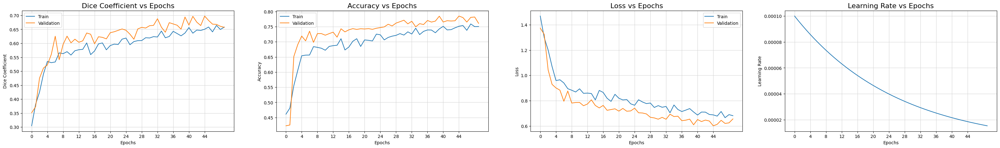

In [33]:
fig, ax = plt.subplots(1, 4, figsize=(40, 5))
ax = ax.ravel()
metrics = ['Dice Coefficient', 'Accuracy', 'Loss', 'Learning Rate']

for i, met in enumerate(['dice_coef', 'accuracy', 'loss', 'lr']):
# metrics = ['Dice Coefficient', 'Accuracy', 'Loss', 'Learning Rate', 'Precision', 'Recall', 'F1 Score']

# for i, met in enumerate(['dice_coef', 'accuracy', 'loss', 'lr', 'recall', 'precision', 'f1']):
    if met != 'lr':
        ax[i].plot(history.history[met])
        ax[i].plot(history.history['val_' + met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,46,4))
        ax[i].legend(['Train', 'Validation'])
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
    else:
        ax[i].plot(history.history[met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,46,4))
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")

plt.savefig('model_metrics_plot.png', facecolor= 'w',transparent= False, bbox_inches= 'tight', dpi= 150)

## Predictions

In [35]:
model.load_weights("simple_InceptionResNetV2.h5")

In [36]:
testing_gen = ValAugmentGenerator(val_images_dir = val_images, val_masks_dir = val_masks, target_size = (512, 512))

Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.
1/1 [==============================] - 0s 44ms/step


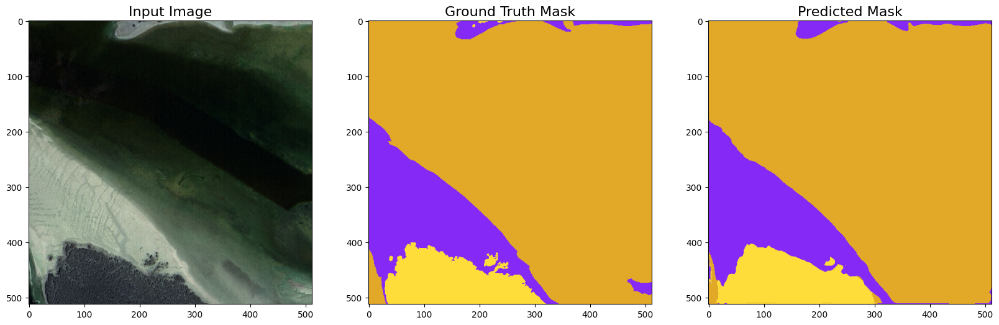

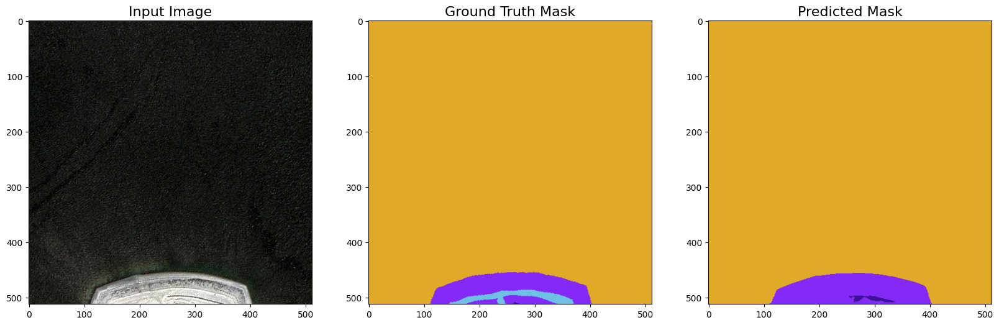

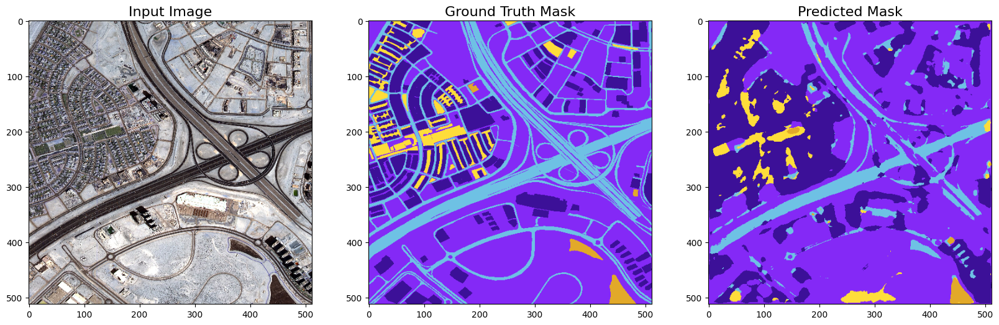

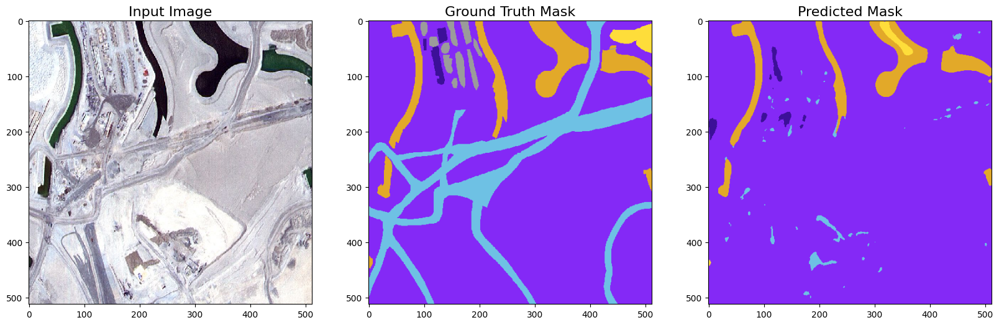

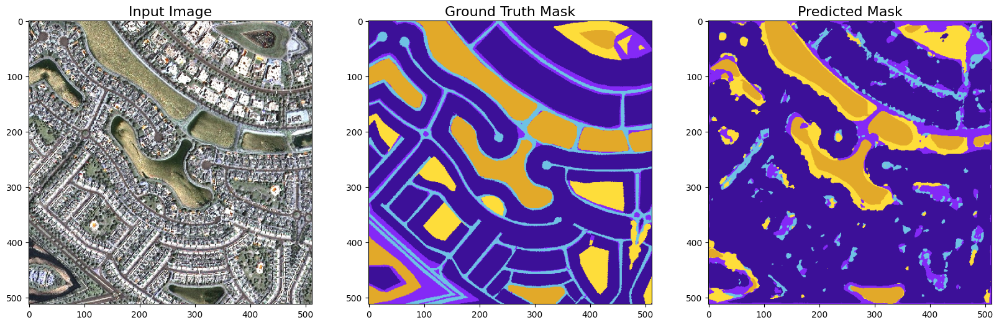

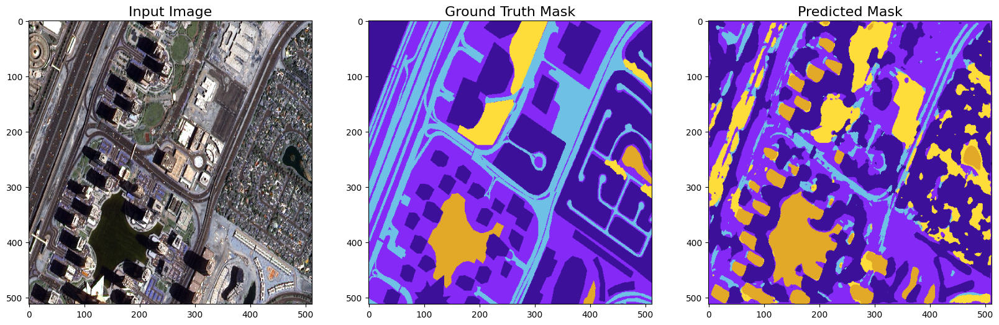

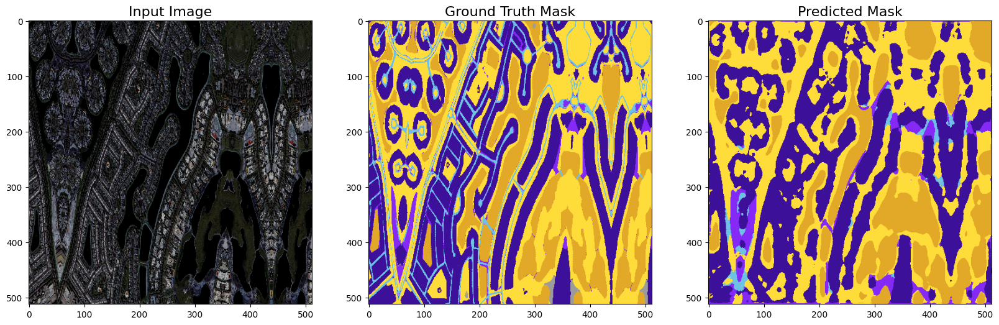

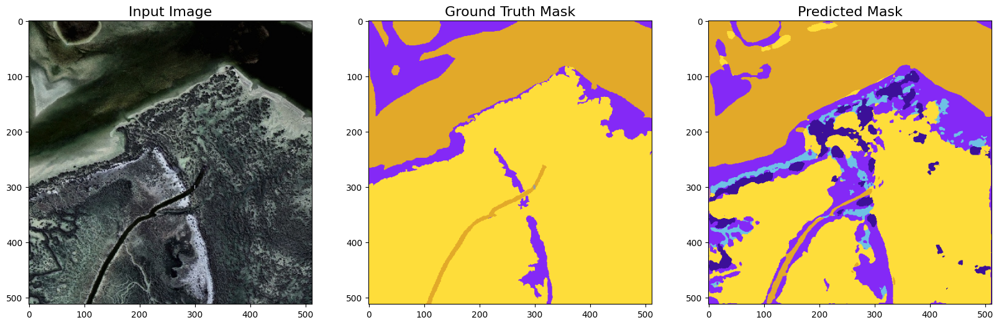

1/1 [==============================] - 0s 44ms/step


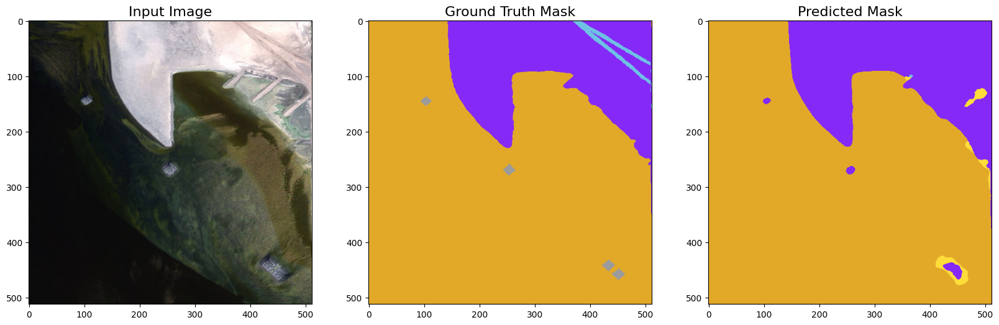

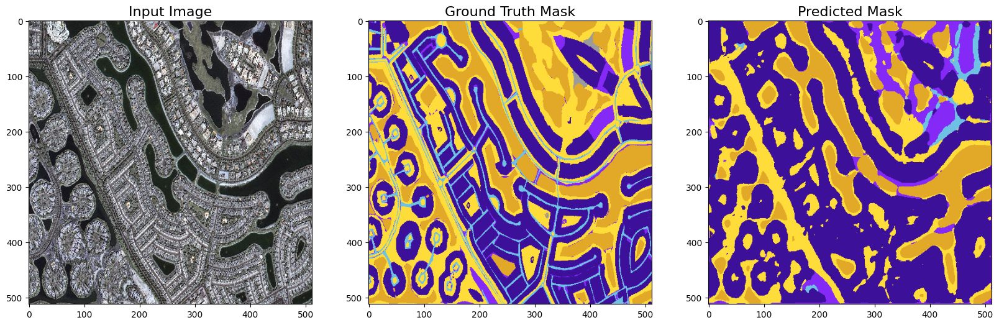

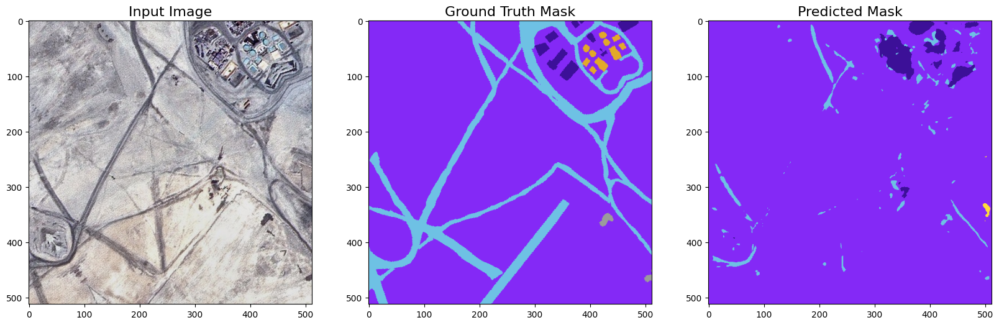

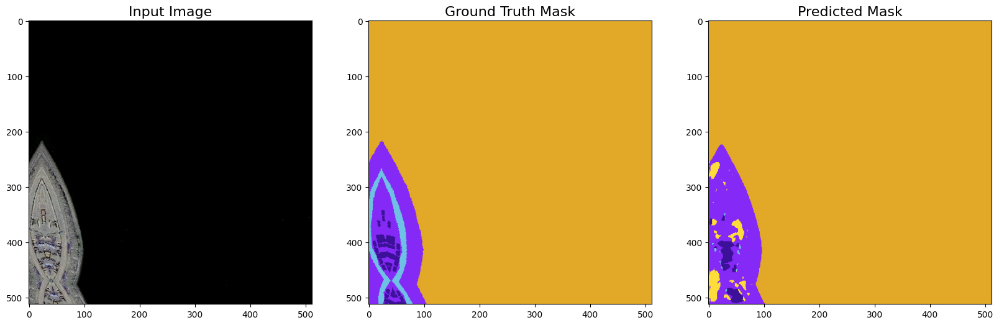

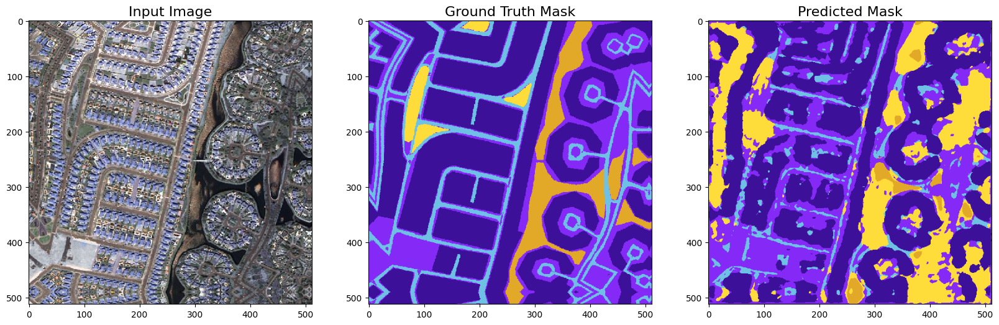

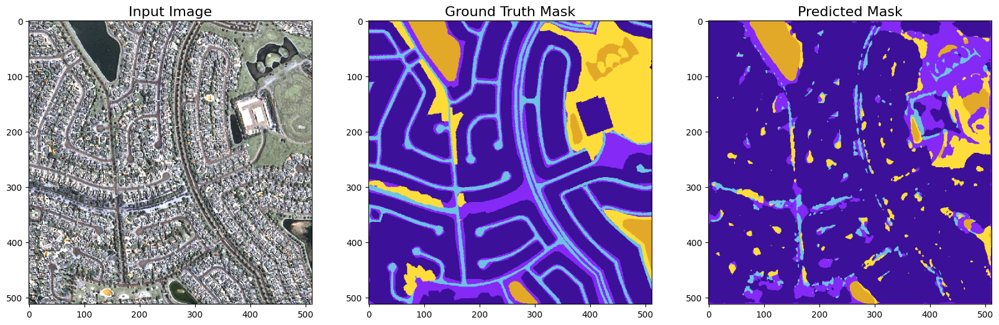

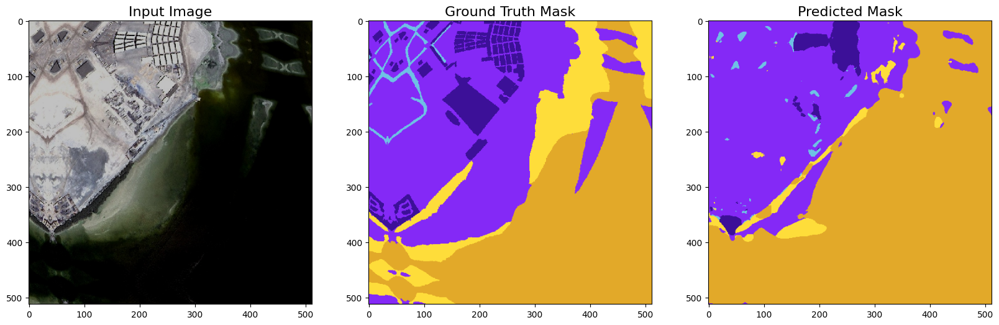

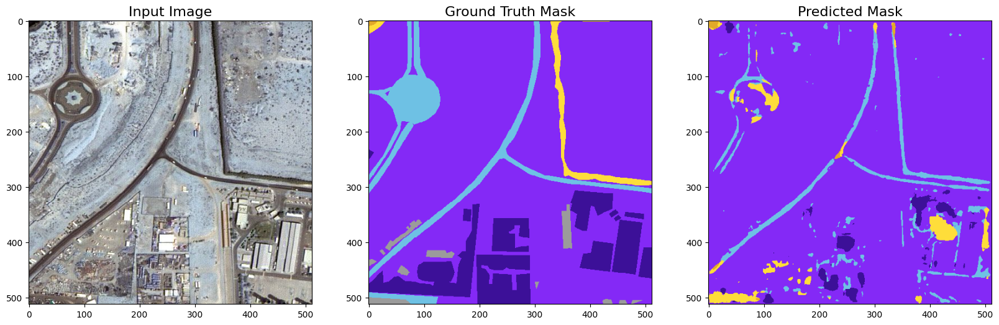

In [37]:
count = 0
for i in range(2):
    batch_img,batch_mask = next(testing_gen)
    pred_all= model.predict(batch_img)
    np.shape(pred_all)

    for j in range(0,np.shape(pred_all)[0]):
        count += 1
        fig = plt.figure(figsize=(20,8))

        ax1 = fig.add_subplot(1,3,1)
        ax1.imshow(batch_img[j])
        ax1.set_title('Input Image', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax1.grid(False)

        ax2 = fig.add_subplot(1,3,2)
        ax2.set_title('Ground Truth Mask', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax2.imshow(onehot_to_rgb(batch_mask[j],id2code))
        ax2.grid(False)

        ax3 = fig.add_subplot(1,3,3)
        ax3.set_title('Predicted Mask', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax3.imshow(onehot_to_rgb(pred_all[j],id2code))
        ax3.grid(False)

        plt.savefig('./prediction_{}.png'.format(count), facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 200)
        plt.show()

In [38]:
from sklearn.metrics import precision_score, recall_score, f1_score

def evaluate_metrics(y_true, y_pred):
    # Flatten the masks
    y_true_flat = y_true.argmax(axis=-1).flatten()
    y_pred_flat = y_pred.argmax(axis=-1).flatten()

    # Compute precision, recall, and F1-score
    precision = precision_score(y_true_flat, y_pred_flat, average='macro')
    recall = recall_score(y_true_flat, y_pred_flat, average='macro')
    f1 = f1_score(y_true_flat, y_pred_flat, average='macro')

    return precision, recall, f1

# Assuming pred_all contains the predicted masks and batch_mask contains the ground truth masks
# Assuming pred_all and batch_mask are in one-hot encoded format
precision, recall, f1 = evaluate_metrics(batch_mask, pred_all)
print("Precision: {:.2f}".format(precision))
print("Recall: {:.2f}".format(recall))
print("F1-score: {:.2f}".format(f1))


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Precision: 0.52
Recall: 0.50
F1-score: 0.50


## Model's Activations (Outputs) Visualization

In [40]:
# image = load_img('../input/augmented-dubai-aerial-imagery-dataset/val_images/val/image_t4_008.jpg', target_size= (512, 512))
image = load_img('/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/test_images/image_t7_005.jpg', target_size= (512, 512))
image = img_to_array(image)
image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
image = preprocess_input(image)
y_hat = model.predict(image)

1/1 [==============================] - 2s 2s/step


In [41]:
layers=['conv2d', 'conv2d_4', 'conv2d_8', 'conv2d_10', 'conv2d_22', 'conv2d_28', 'conv2d_34', 'conv2d_40', 'conv2d_52', 'conv2d_61', 'conv2d_67', 'conv2d_70']

conv2d (1, 512, 512, 32) 


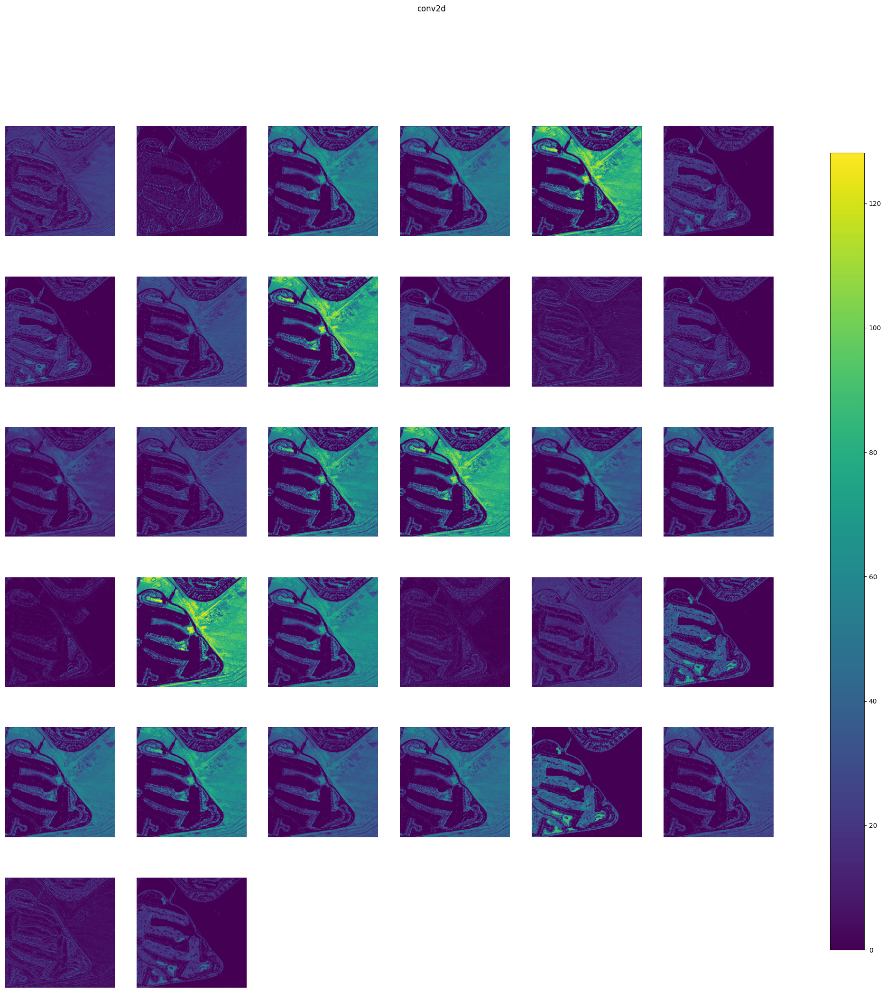

conv2d_4 (1, 128, 128, 128) 


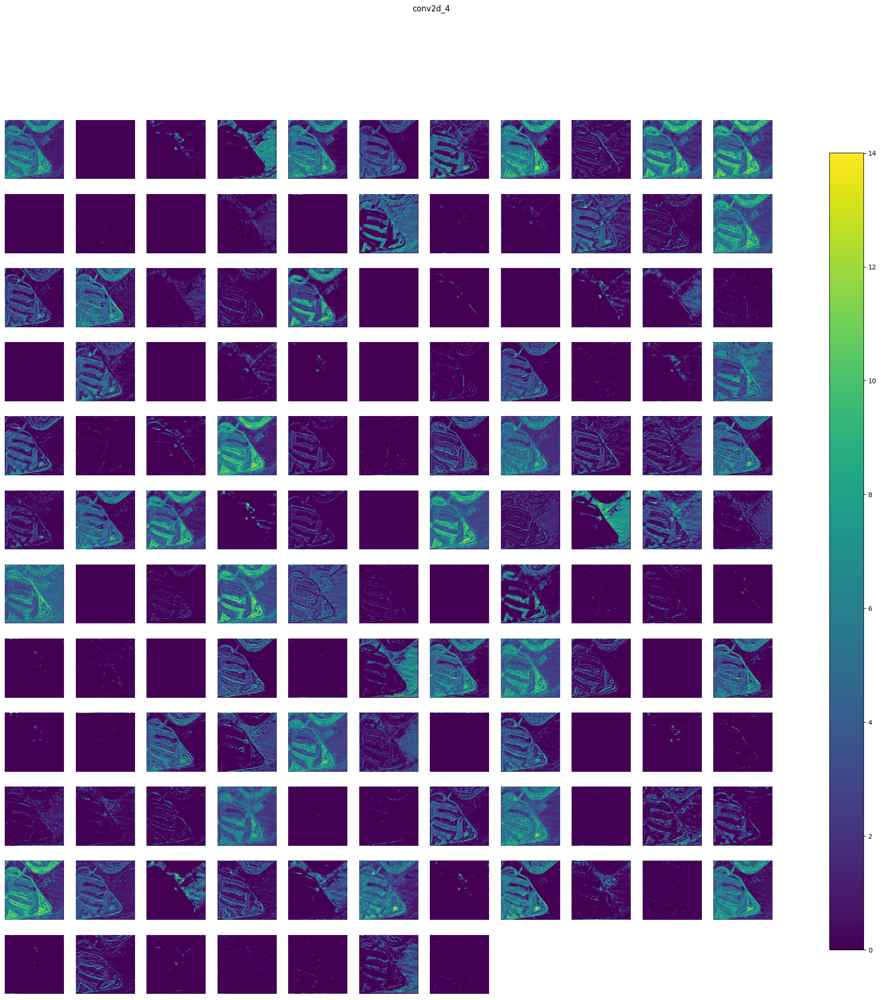

conv2d_8 (1, 128, 128, 128) 


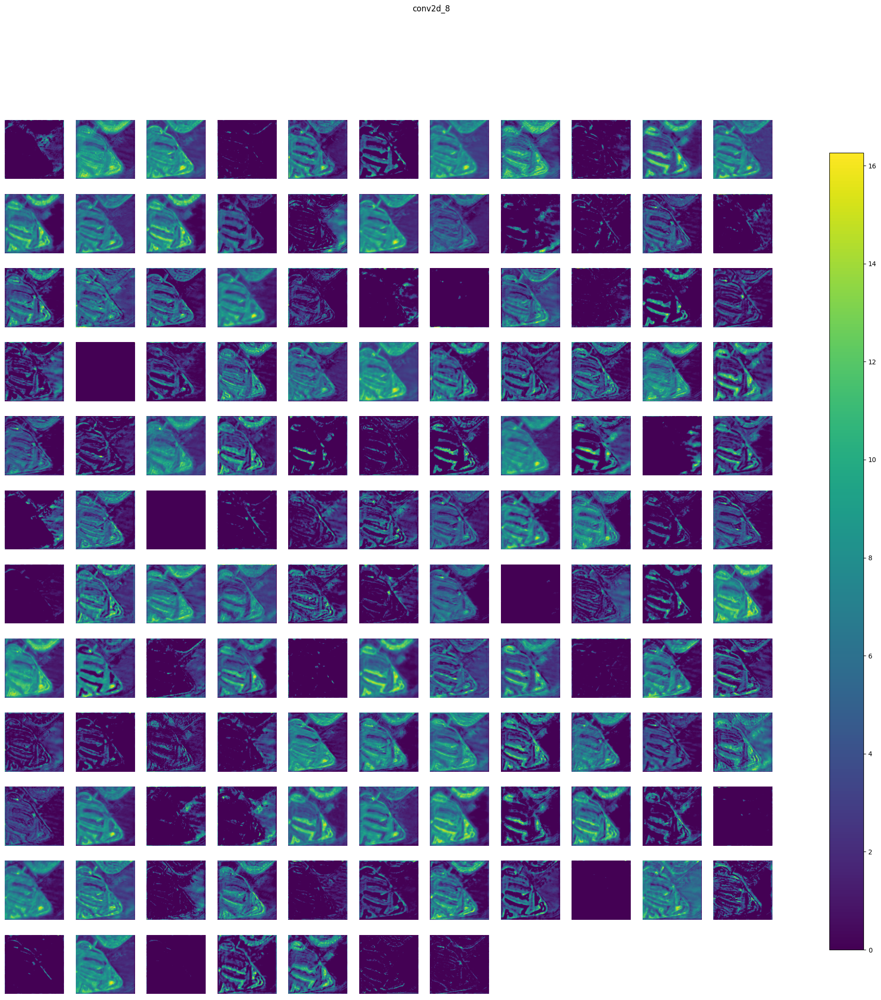

conv2d_10 (1, 256, 256, 64) 


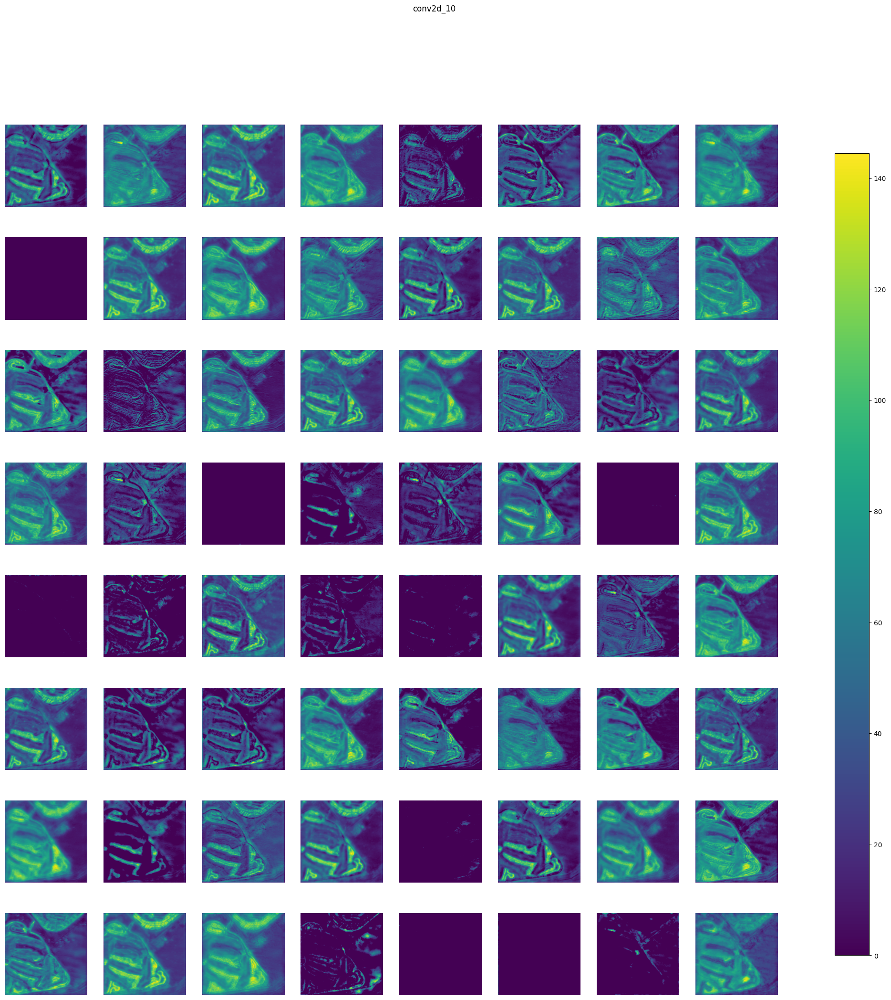

In [42]:
activations= keract.get_activations(model, image, layer_names= layers, nodes_to_evaluate= None, output_format= 'simple', auto_compile= True)
keract.display_activations(activations, cmap='viridis', save= False, directory= './activations')